## Import library

In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import missingno as msno

import plotly.offline as py
py.init_notebook_mode(connected=True)
import plotly.graph_objs as go
import plotly.tools as tls

%matplotlib inline
plt.style.use('fivethirtyeight')


## Read data set

In [4]:
path ='file/'

metro_ts = pd.read_csv(path+'Metro_time_series.csv',parse_dates=['Date'])
print('Number of rows and columns in Metro ts:',metro_ts.shape)

Number of rows and columns in Metro ts: (189049, 102)


In [5]:
metro_ts.head()

,Date,RegionName,AgeOfInventory,DaysOnZillow_AllHomes,HomesSoldAsForeclosuresRatio_AllHomes,InventorySeasonallyAdjusted_AllHomes,InventoryRaw_AllHomes,InventorySeasonallyAdjusted_BottomTier,InventorySeasonallyAdjusted_MiddleTier,InventorySeasonallyAdjusted_TopTier,...,ZHVI_BottomTier,ZHVI_CondoCoop,ZHVI_MiddleTier,ZHVI_SingleFamilyResidence,ZHVI_TopTier,ZRI_AllHomes,ZRI_AllHomesPlusMultifamily,ZriPerSqft_AllHomes,Zri_MultiFamilyResidenceRental,Zri_SingleFamilyResidenceRental
0,1996-04-30,10180,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1996-04-30,10220,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,28600.0,28600.0,NaN,NaN,NaN,NaN,NaN,NaN
2,1996-04-30,10300,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,53000.0,NaN,78500.0,78600.0,124800.0,NaN,NaN,NaN,NaN,NaN
3,1996-04-30,10420,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,54900.0,109000.0,95700.0,94400.0,169400.0,NaN,NaN,NaN,NaN,NaN
4,1996-04-30,10500,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,67600.0,67500.0,112400.0,NaN,NaN,NaN,NaN,NaN


In [6]:
metro_ts.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 189049 entries, 0 to 189048
Columns: 102 entries, Date to Zri_SingleFamilyResidenceRental
dtypes: datetime64[ns](1), float64(100), object(1)
memory usage: 147.1+ MB


In [7]:
metro_ts.describe()

,AgeOfInventory,DaysOnZillow_AllHomes,HomesSoldAsForeclosuresRatio_AllHomes,InventorySeasonallyAdjusted_AllHomes,InventoryRaw_AllHomes,InventorySeasonallyAdjusted_BottomTier,InventorySeasonallyAdjusted_MiddleTier,InventorySeasonallyAdjusted_TopTier,MedianListingPricePerSqft_1Bedroom,MedianListingPricePerSqft_2Bedroom,...,ZHVI_BottomTier,ZHVI_CondoCoop,ZHVI_MiddleTier,ZHVI_SingleFamilyResidence,ZHVI_TopTier,ZRI_AllHomes,ZRI_AllHomesPlusMultifamily,ZriPerSqft_AllHomes,Zri_MultiFamilyResidenceRental,Zri_SingleFamilyResidenceRental
count,22984.000000,23514.000000,26970.000000,6.587200e+04,6.587200e+04,33714.000000,35198.000000,37873.000000,7752.000000,39642.000000,...,118009.000000,82765.000000,1.360410e+05,1.358560e+05,1.413630e+05,54746.000000,54959.000000,54333.000000,43943.000000,54750.000000
mean,91.470849,116.366884,5.198917,4.609629e+03,4.606861e+03,2070.481847,2218.976590,3078.961186,214.178903,116.753242,...,96421.533951,138460.882015,1.404139e+05,1.431609e+05,2.331148e+05,1131.823001,1123.992212,0.771365,1014.424072,1134.703799
std,29.142503,32.753476,8.110955,6.660405e+04,6.663992e+04,22239.877531,24385.637242,34978.730887,135.501700,67.709685,...,61733.953932,75209.421629,8.644479e+04,9.214465e+04,1.596153e+05,313.456908,308.657490,0.209317,285.618081,323.463769
min,16.000000,5.000000,0.014200,2.100000e+01,1.900000e+01,9.000000,7.000000,13.000000,41.548295,31.197147,...,21800.000000,37700.000000,2.860000e+04,2.860000e+04,4.840000e+04,567.000000,559.000000,0.390000,498.000000,560.000000
25%,70.000000,93.875000,1.108950,2.810000e+02,2.790000e+02,141.000000,143.250000,221.000000,128.687520,76.354463,...,60200.000000,96800.000000,8.960000e+04,8.980000e+04,1.484000e+05,933.000000,930.000000,0.640000,829.000000,933.000000
50%,89.000000,114.250000,2.994200,6.390000e+02,6.340000e+02,308.000000,328.000000,492.000000,171.875000,99.825289,...,77000.000000,119700.000000,1.169000e+05,1.175000e+05,1.887000e+05,1074.000000,1065.000000,0.728000,955.000000,1075.000000
75%,110.000000,135.500000,6.284225,1.590250e+03,1.578250e+03,797.000000,861.000000,1231.000000,247.644902,135.778986,...,112400.000000,153800.000000,1.589000e+05,1.612000e+05,2.595000e+05,1234.000000,1227.000000,0.848000,1124.000000,1237.000000
max,222.000000,702.666667,431.609600,2.348391e+06,2.477960e+06,606095.000000,662087.000000,919863.000000,912.857143,647.348952,...,680300.000000,754900.000000,1.038900e+06,1.130600e+06,1.866600e+06,3715.000000,3673.000000,2.600000,3114.000000,4233.000000


## Missing value

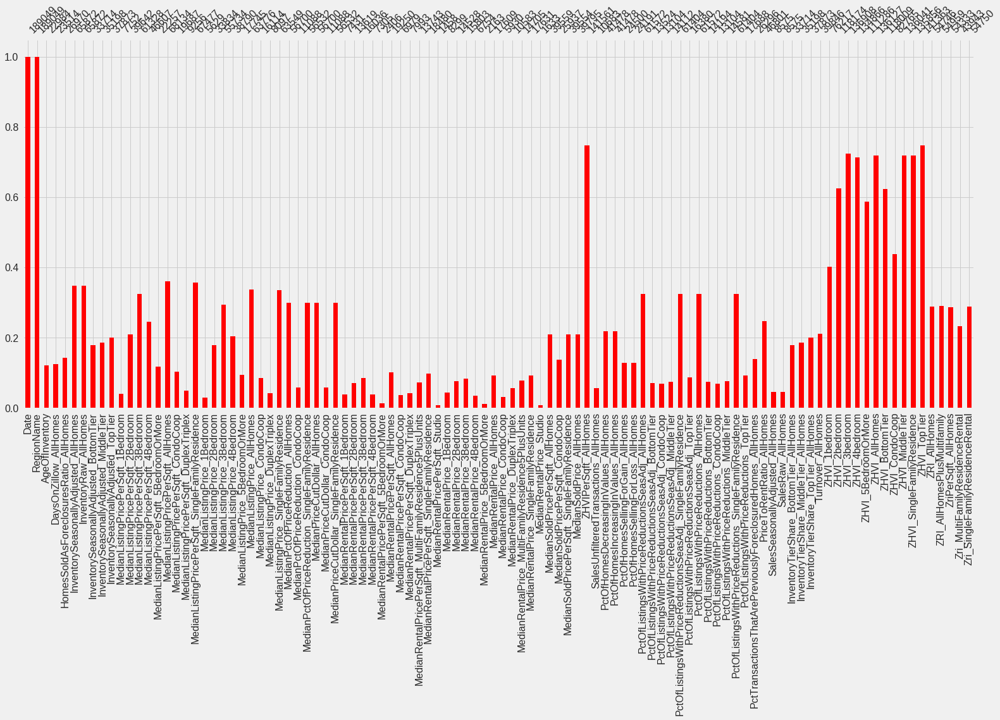

In [8]:
msno.bar(metro_ts,color='r')

In [9]:
# percentage of missing value in data  set
missing = metro_ts.isnull().sum().sum()
missing * 100/ (metro_ts.shape[0]*metro_ts.shape[1])

77.0104368625667

### Data analysis
Let's look at the date feature

In [10]:
print('Date range:{} to {}'.format(metro_ts['Date'].min(),metro_ts['Date'].max()))
print('\n',metro_ts['Date'].describe())

Date range:1996-04-30 00:00:00 to 2017-08-31 00:00:00

 count                  189049
unique                    257
top       2016-10-31 00:00:00
freq                      910
first     1996-04-30 00:00:00
last      2017-08-31 00:00:00
Name: Date, dtype: object


In [98]:
metro_ts['DaysOnZillow_AllHomes'].describe()

count    4458.000000
mean      112.027740
std        31.879683
min        43.000000
25%        91.406250
50%       110.625000
75%       129.250000
max       796.500000
Name: DaysOnZillow_AllHomes, dtype: float64

In [12]:
data = [go.Scatter(x=metro_ts['Date'],y = metro_ts['DaysOnZillow_AllHomes'],line = dict(color = '#17BECF'))]
layout = {'title': 'Days On Zillow All Homes', 'font': dict(size=16),'xaxis':{'range':['2010-01-01','2017-08-01']}}
#fig = dict(data,layout)
py.iplot({'data':data,
         'layout': layout})

In [59]:
k = metro_ts.groupby(['RegionName']).sum()

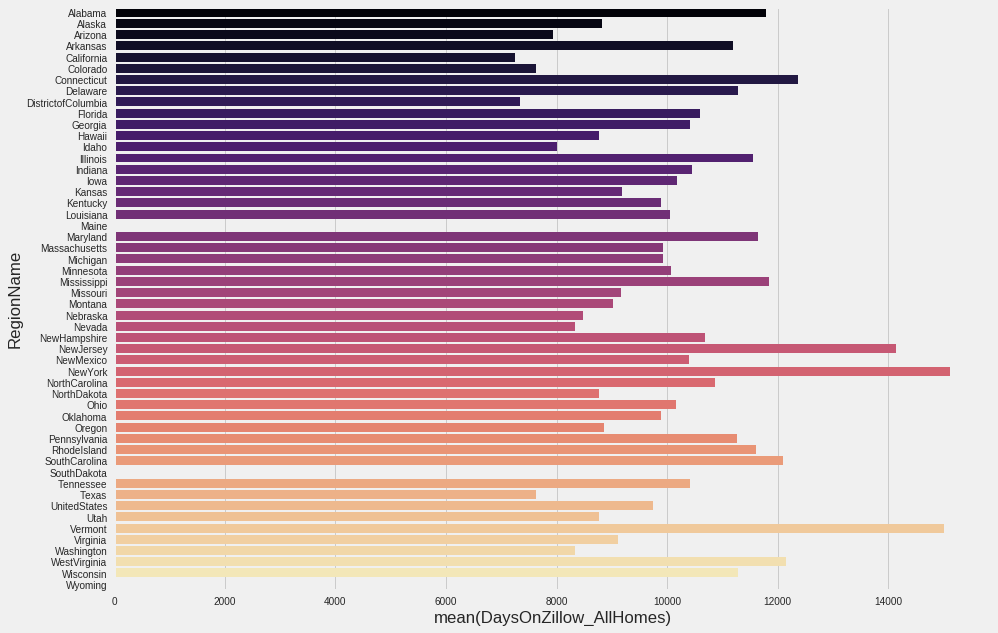

In [63]:
plt.figure(figsize=(14,10))
sns.barplot(k['DaysOnZillow_AllHomes'],k.index,palette='magma')

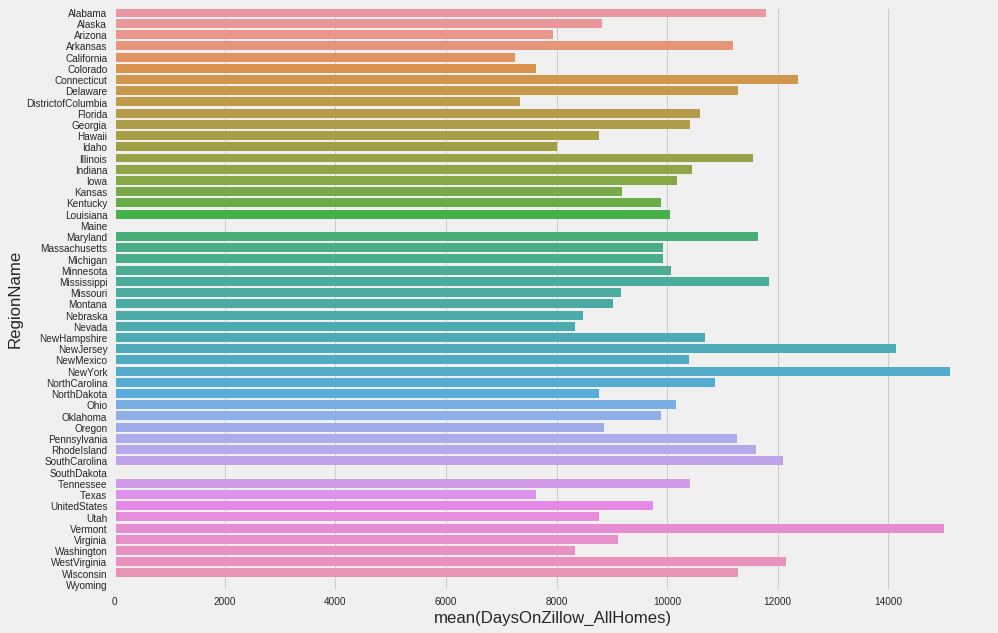

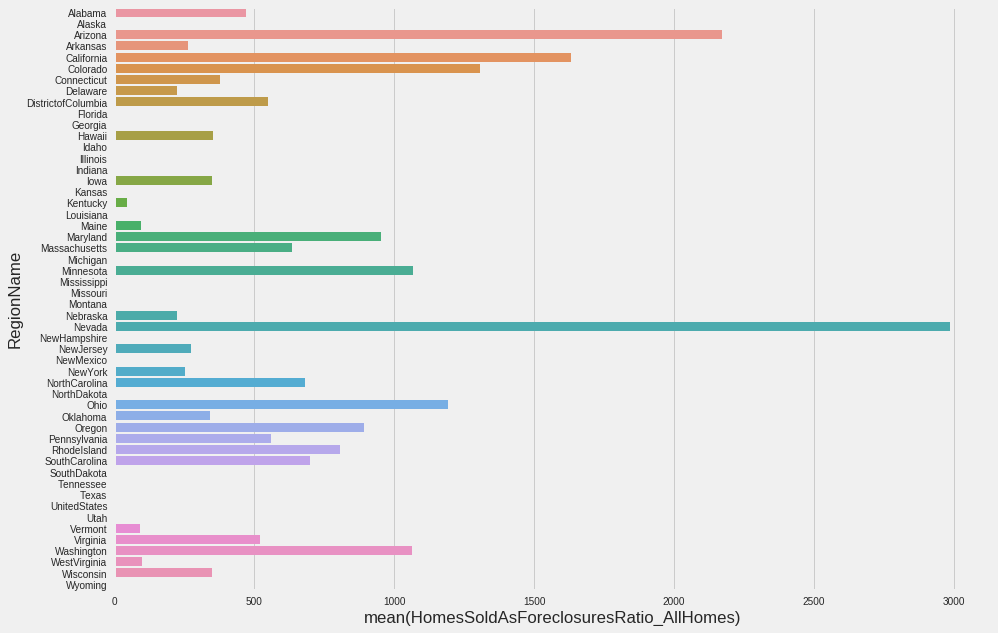

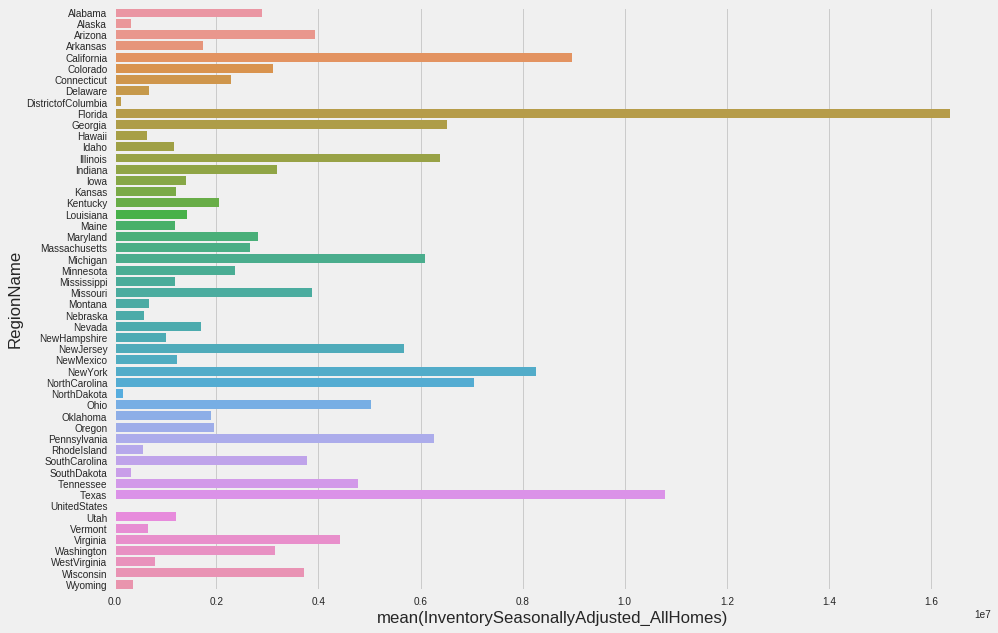

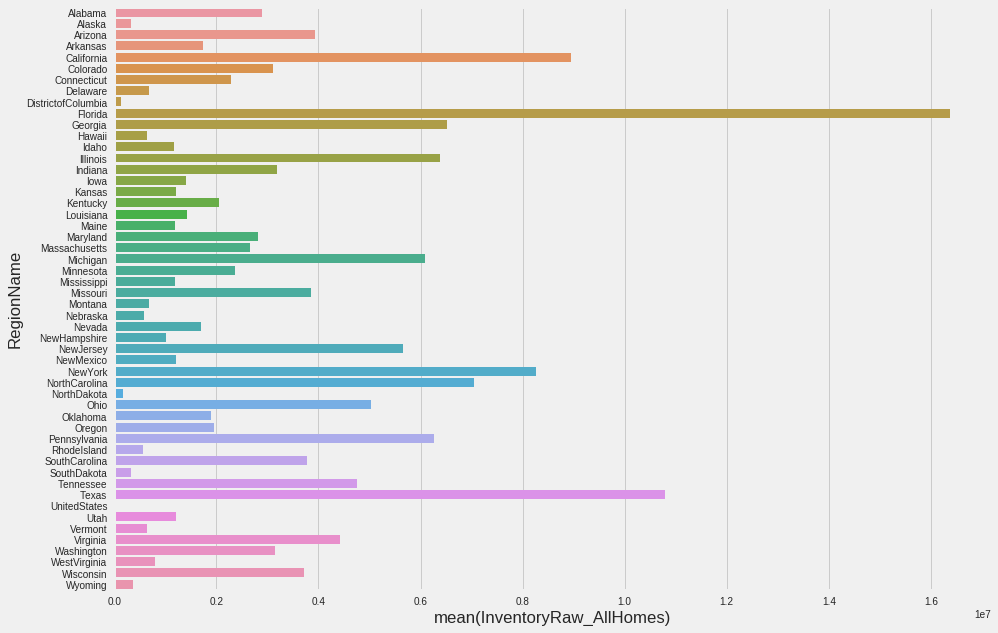

In [76]:
for c in k.columns[:4]:
    plt.figure(figsize=(14,10))
    sns.barplot(k[c],k.index)

In [15]:
data = [go.Scatter(x=metro_ts['Date'],y = metro_ts['Turnover_AllHomes'],line = dict(color = '#17BECF'))]
layout = {'title': 'Days On Zillow All Homes', 'font': dict(size=16)}
#fig = dict(data,layout)
py.iplot({'data':data,
         'layout': layout})

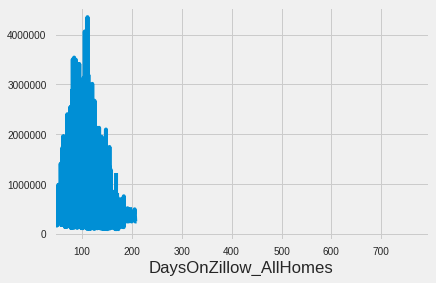

In [89]:
m = metro_ts.groupby(['DaysOnZillow_AllHomes']).sum()
m['ZHVI_AllHomes'].plot()

In [32]:
metro_month = metro_ts.resample('M',on='Date').mean()

In [33]:
metro_month.head()

,AgeOfInventory,DaysOnZillow_AllHomes,HomesSoldAsForeclosuresRatio_AllHomes,InventorySeasonallyAdjusted_AllHomes,InventoryRaw_AllHomes,InventorySeasonallyAdjusted_BottomTier,InventorySeasonallyAdjusted_MiddleTier,InventorySeasonallyAdjusted_TopTier,MedianListingPricePerSqft_1Bedroom,MedianListingPricePerSqft_2Bedroom,...,ZHVI_BottomTier,ZHVI_CondoCoop,ZHVI_MiddleTier,ZHVI_SingleFamilyResidence,ZHVI_TopTier,ZRI_AllHomes,ZRI_AllHomesPlusMultifamily,ZriPerSqft_AllHomes,Zri_MultiFamilyResidenceRental,Zri_SingleFamilyResidenceRental
Date,,,,,,,,,,,,,,,,,,,,,
1996-04-30,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,63668.436578,87998.795181,88345.124717,90543.497758,140636.000000,NaN,NaN,NaN,NaN,NaN
1996-05-31,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,63594.411765,88027.091633,88553.846154,90767.785235,140765.188470,NaN,NaN,NaN,NaN,NaN
1996-06-30,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,63495.294118,88123.107570,88669.909502,90897.539150,140751.106195,NaN,NaN,NaN,NaN,NaN
1996-07-31,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,63309.384164,88179.681275,88690.497738,90935.570470,140814.159292,NaN,NaN,NaN,NaN,NaN
1996-08-31,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,63254.252199,88261.752988,88747.737557,91006.711409,140960.176991,NaN,NaN,NaN,NaN,NaN


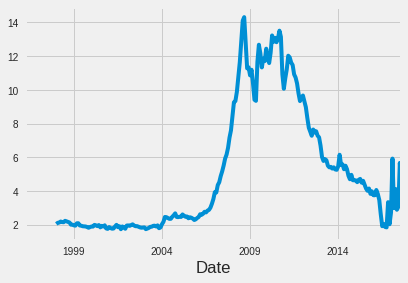

In [34]:
metro_month['HomesSoldAsForeclosuresRatio_AllHomes'].plot()

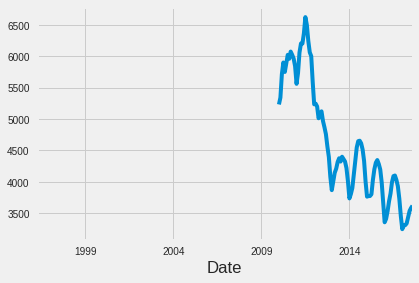

In [35]:
metro_month['InventoryRaw_AllHomes'].plot()

In [ ]:
metro_month['InventorySeasonallyAdjusted_AllHomes'].plot()